In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import scanpy as sc
import matplotlib.pyplot as plt 
import seaborn as sns 
import numpy as np
import pandas as pd 
import os, json, pickle


In [3]:
import sys 
sys.path.append('../src')

from spaceoracle import SpaceTravLR
from spaceoracle.tools.network import DayThreeRegulatoryNetwork

%config InlineBackend.figure_format = 'retina'

co_grn = DayThreeRegulatoryNetwork()
adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data/day3_lymph_rep_1.h5ad')

2024-11-21 19:34:42.097500: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [4]:
from spaceoracle.plotting.layout import *
from spaceoracle.plotting.transitions import * 
from spaceoracle.plotting.niche import *


In [5]:
kos = np.loadtxt('.cache/lymph/kos.txt', dtype=str)
kos = [x.capitalize() for x in kos]
set(kos) & set(adata.var_names)

{'Bach2', 'Bcl6', 'Foxp3', 'Il2', 'Pax5', 'Prdm1', 'Satb1'}

In [6]:
goi = 'Bcl6'
goi in adata.var_names

True

### Load model results

In [7]:
so = SpaceTravLR(
    adata=adata,
    save_dir='/ix/djishnu/shared/djishnu_kor11/models_v2',
    annot='rctd_cluster', 
    grn=co_grn
)

results_dir = '/ix/djishnu/shared/djishnu_kor11/results/lymph'

In [8]:
_ = so.perturb(target=goi, n_propagation=3, gene_expr=0)

with open('.cache/lymph/bdb.pkl', 'wb') as f:
    pickle.dump(so.beta_dict, f)

np.save(f'{results_dir}/gem_simulated/{goi}_gem_simulated.npy', 
        so.adata.layers['simulated_count'])

np.savetxt('.cache/lymph/ligands.txt', np.array(list(so.ligands)), fmt='%s')

Computing beta_dict


Running simulation 3/3: 100%|██████████| 11567/11567 [04:38<00:00, 41.58it/s]


In [9]:
gem_simulated = np.load(f'{results_dir}/gem_simulated/{goi}_gem_simulated.npy')
so.adata.layers['simulated_count'] = gem_simulated

gene_mtx = so.adata.layers['imputed_count']
delta_X = gem_simulated - gene_mtx
so.adata.layers['delta_X'] = delta_X

In [10]:
with open('.cache/lymph/bdb.pkl', 'rb') as f:
    so.beta_dict = pickle.load(f)

so.ligands = set(np.loadtxt('.cache/lymph/ligands.txt', dtype=str))

### Contour shift

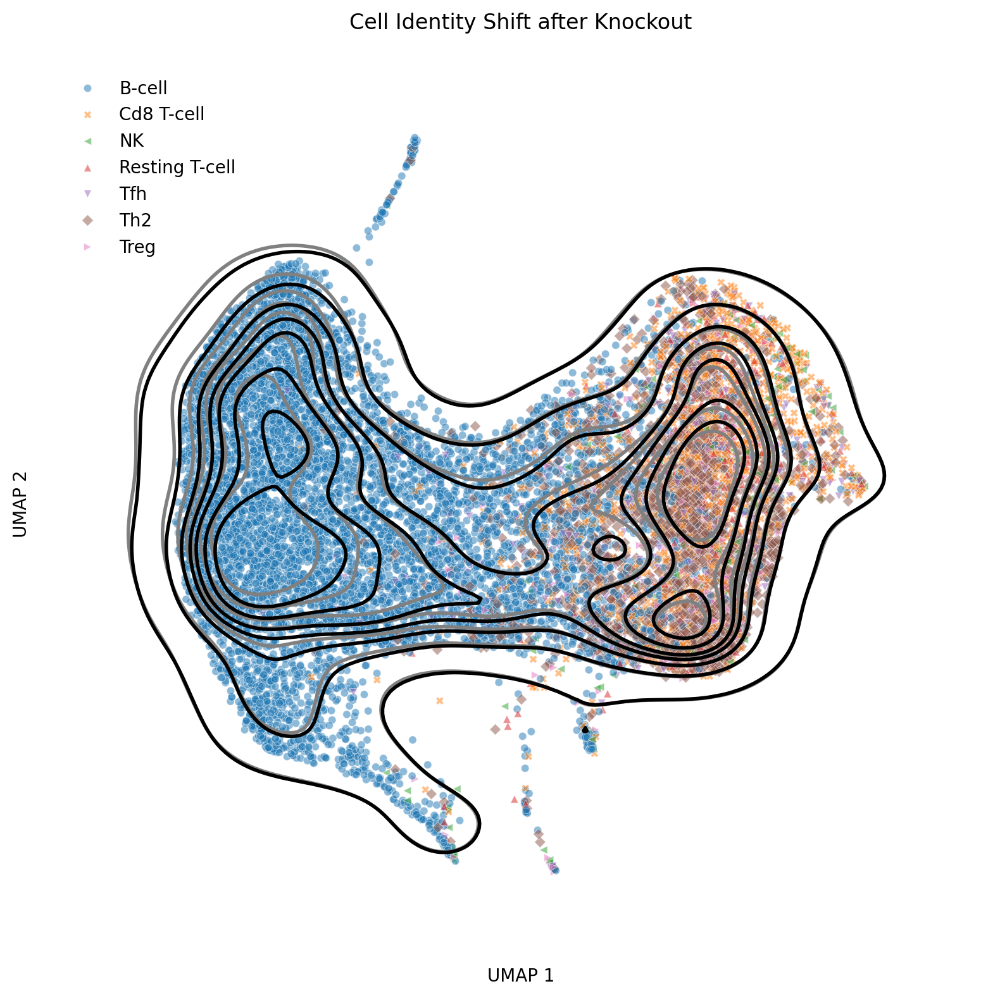

In [11]:
from spaceoracle.plotting.transitions import contour_shift

contour_shift(so.adata, savepath=f'{results_dir}/transitions/contours/{goi}.png',)

### Beta Heatmap

In [12]:
so.compute_betas()

  4%|▎         | 71/2000 [00:02<00:52, 36.40it/s]

100%|██████████| 3020/3020 [02:50<00:00, 17.69it/s] 


Ligand interactions: 100%|██████████| 2000/2000 [01:25<00:00, 23.51it/s]


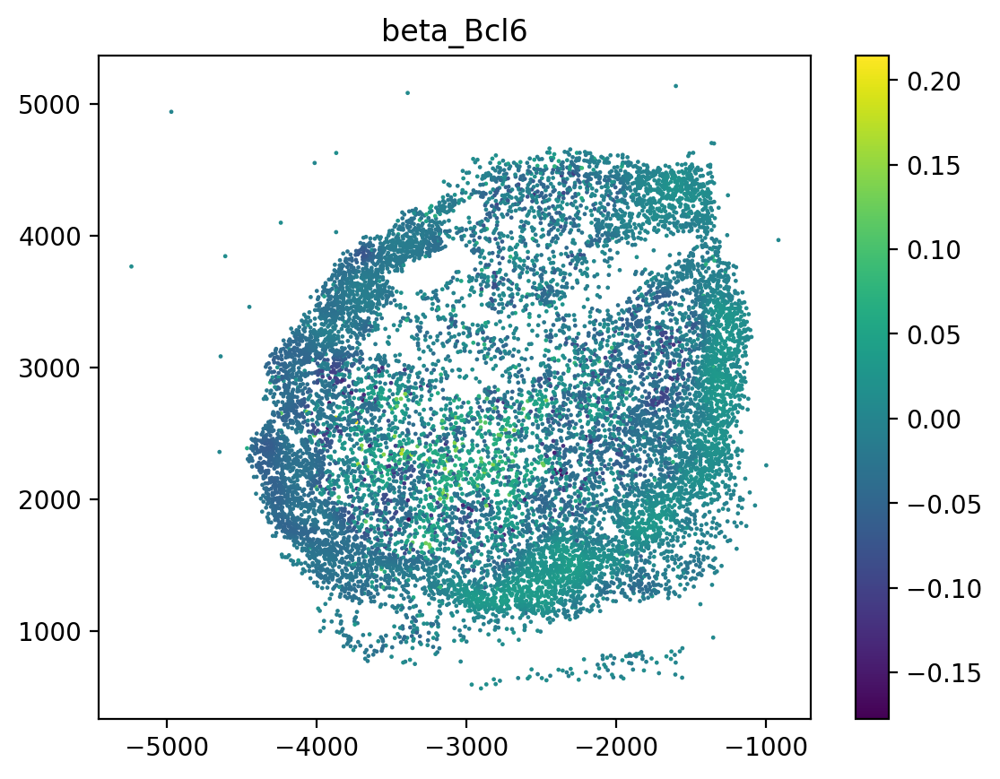

In [13]:
goi_betas_all = get_modulator_betas(so, goi, save_dir=f'{results_dir}/betas')
# goi_betas_all = pd.read_csv(f'{results_dir}/betas/beta_{goi}_all.csv', index_col=0)

### Neighborhoods

B-cell 0.3973316262701226
Cd8 T-cell 0.5011917539019507
NK 0.587171391358605
Resting T-cell 0.5620223658971647
Tfh 0.4952355463627022
Th2 0.5332577070734571
Treg 0.521926525082429


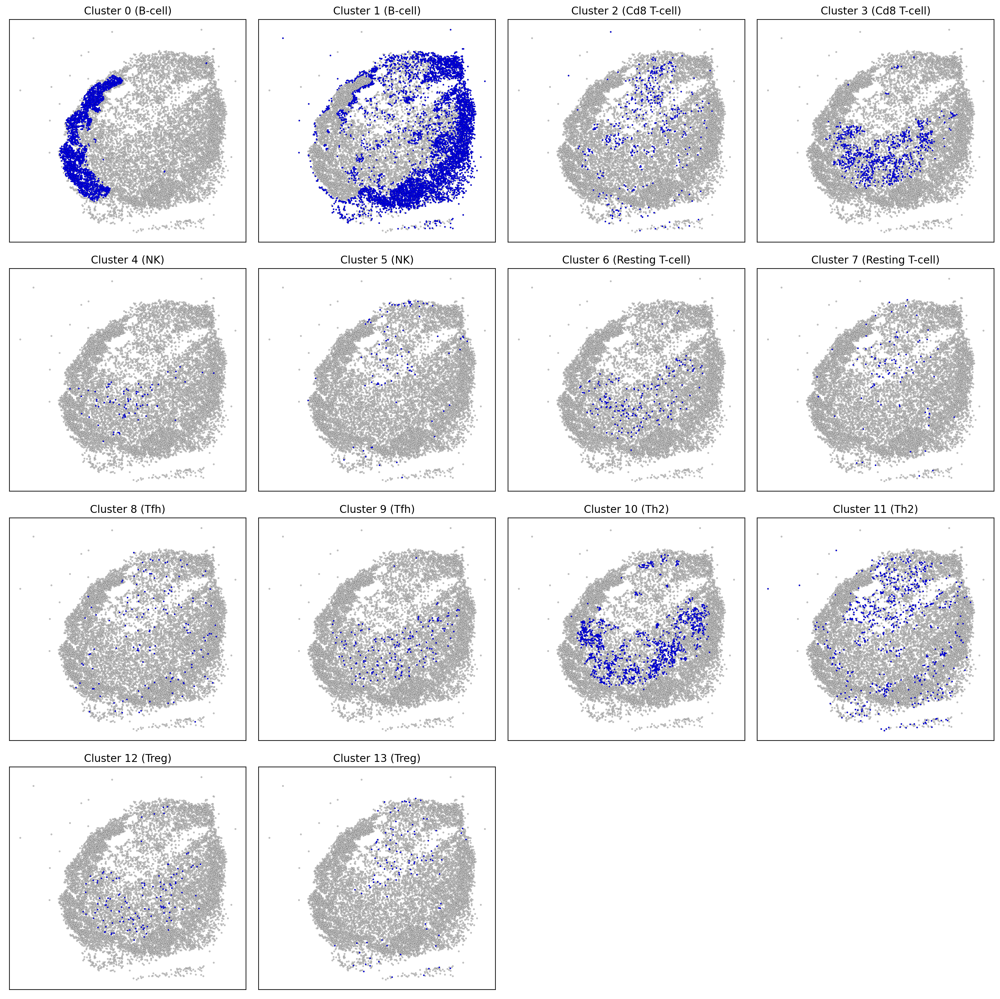

B-cell 0.48851705
Cd8 T-cell 0.49416816
NK 0.58746654
Resting T-cell 0.45794883
Tfh 0.5060841
Th2 0.49967667
Treg 0.37484264


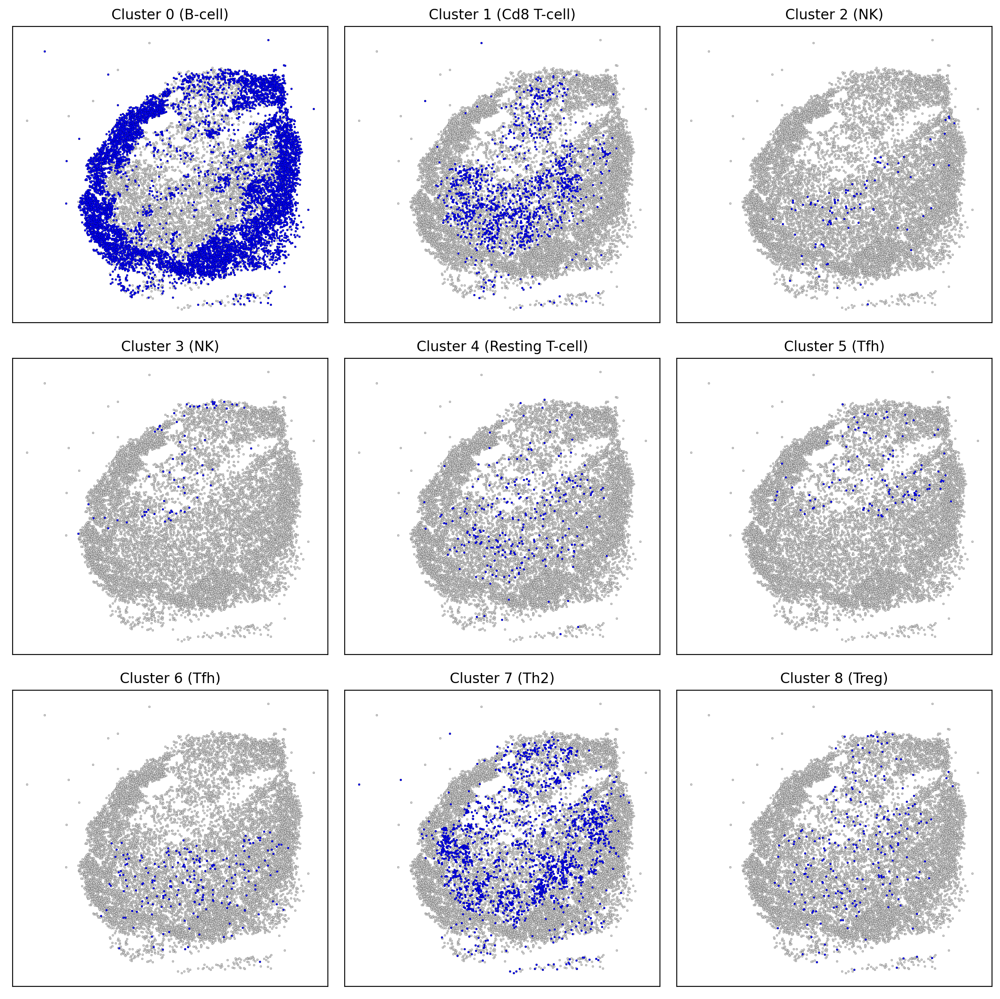

In [14]:
from spaceoracle.plotting.niche import show_beta_neighborhoods

betas = goi_betas_all.values
gbeta_labels = show_beta_neighborhoods(
    so, goi, betas, score_thresh=0.3, annot='rctd_celltypes', 
    savepath=f'{results_dir}/neighborhoods/beta_{goi}.png')

beta_labels = show_beta_neighborhoods(
    so, goi, betas=None, annot='rctd_celltypes', 
    savepath=f'{results_dir}/neighborhoods/{goi}_betas.png')

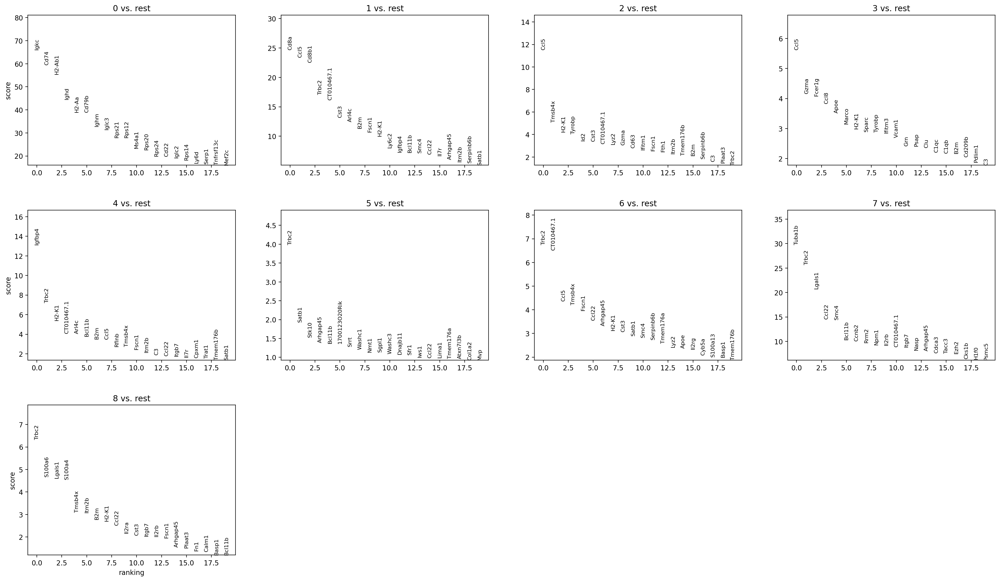

In [15]:
adata.obs['beta_labels'] = beta_labels
adata.obs['beta_labels'] = adata.obs['beta_labels'].astype(str)
sc.tl.rank_genes_groups(adata, groupby='beta_labels', method='wilcoxon')
ax = sc.pl.rank_genes_groups(
    adata, n_genes=20, sharey=False, show=False)
plt.savefig(f'{results_dir}/neighborhoods/degs_betas/{goi}.png', dpi=300)

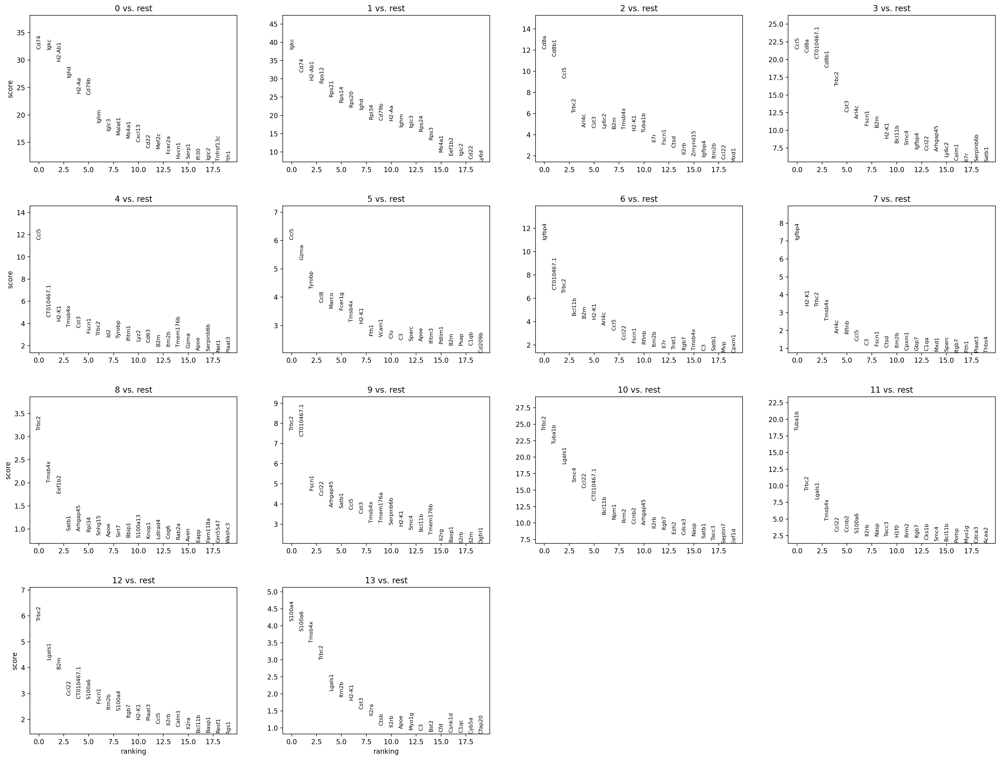

In [16]:
adata.obs['beta_labels'] = gbeta_labels
adata.obs['beta_labels'] = adata.obs['beta_labels'].astype(str)

sc.tl.rank_genes_groups(adata, groupby='beta_labels', method='wilcoxon')
sc.pl.rank_genes_groups(
    adata, n_genes=20, sharey=False, show=False)
plt.savefig(f'{results_dir}/neighborhoods/beta_degs/{goi}.png')

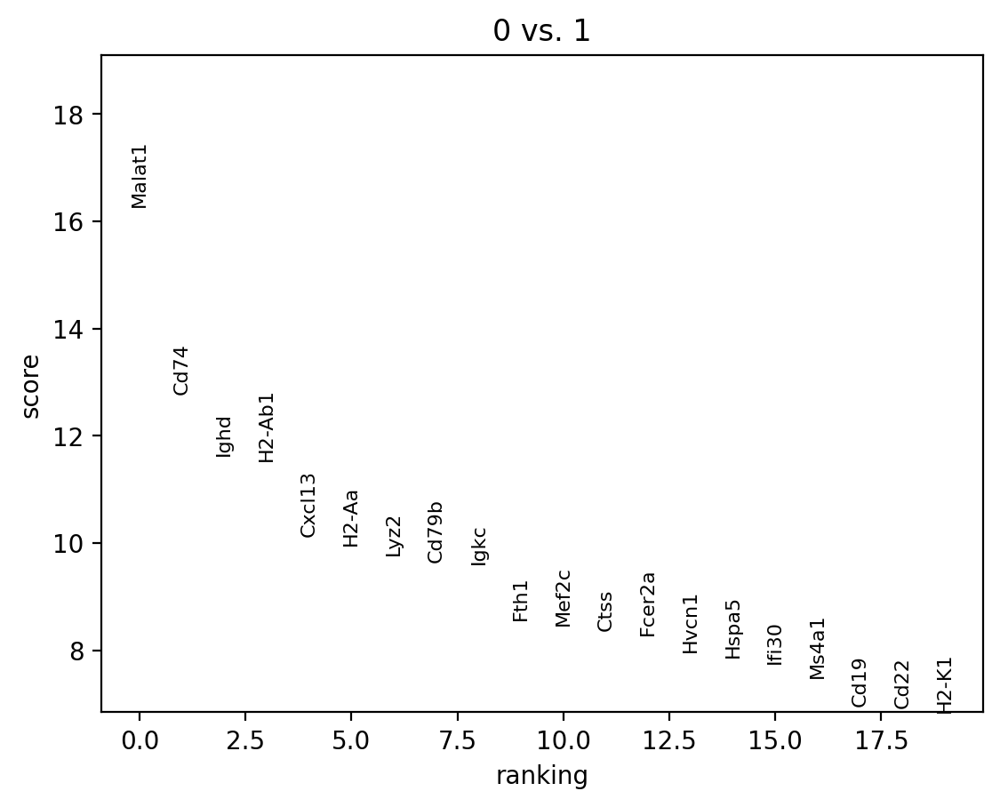

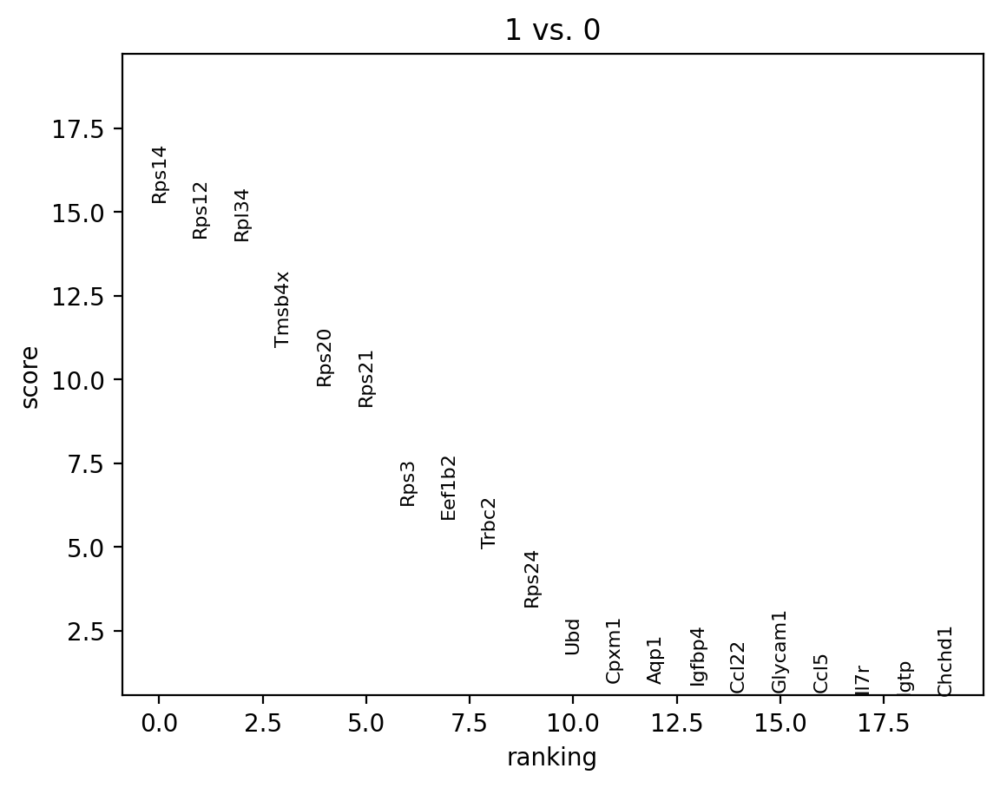

In [17]:
a, b = '0', '1'
sc.tl.rank_genes_groups(adata, groupby='beta_labels', groups=[a], reference=b, method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

sc.tl.rank_genes_groups(adata, groupby='beta_labels', groups=[b], reference=a, method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

### Beta transitions

In [18]:
so.adata.obs['beta_labels'] = gbeta_labels
so.adata.obs['beta_labels'] = so.adata.obs['beta_labels'].astype('category')

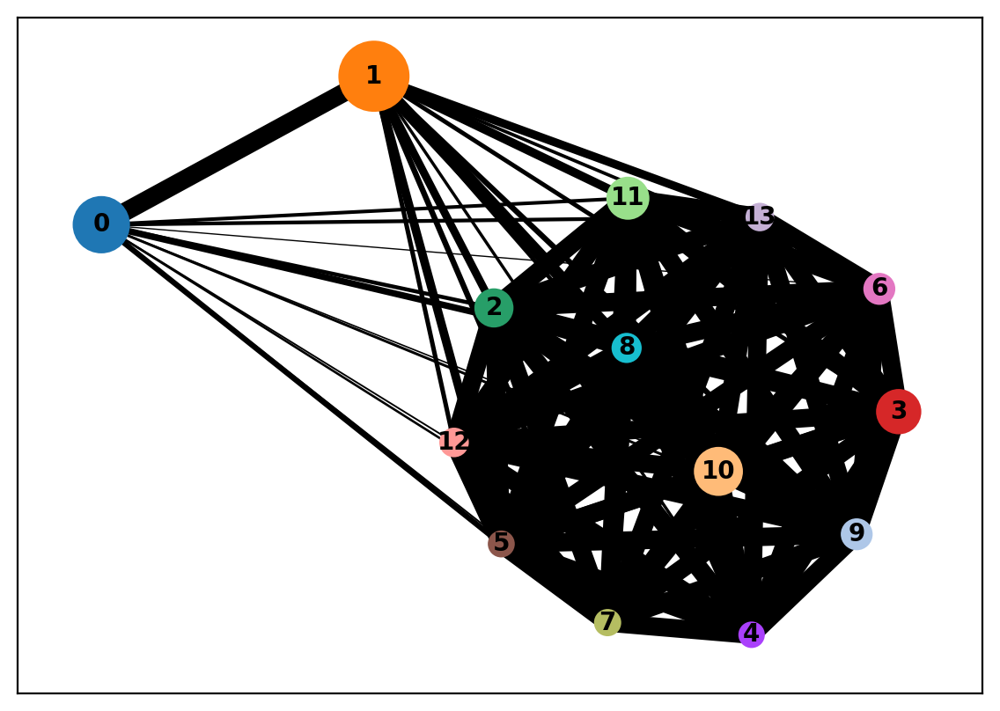

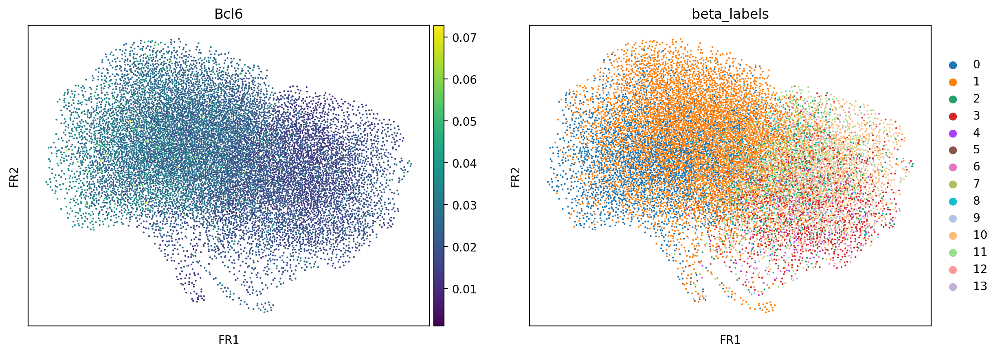

In [19]:
# compare_gex(so.adata, annot='beta_labels', goi=goi, embedding='PCA')
compare_gex(so.adata, annot='beta_labels', goi=goi, embedding='FR', savepath=f'{results_dir}/transitions/beta/layouts/{goi}.png')

Computing vectors: 100%|██████████| 1520/1520 [00:00<00:00, 38723.16it/s]


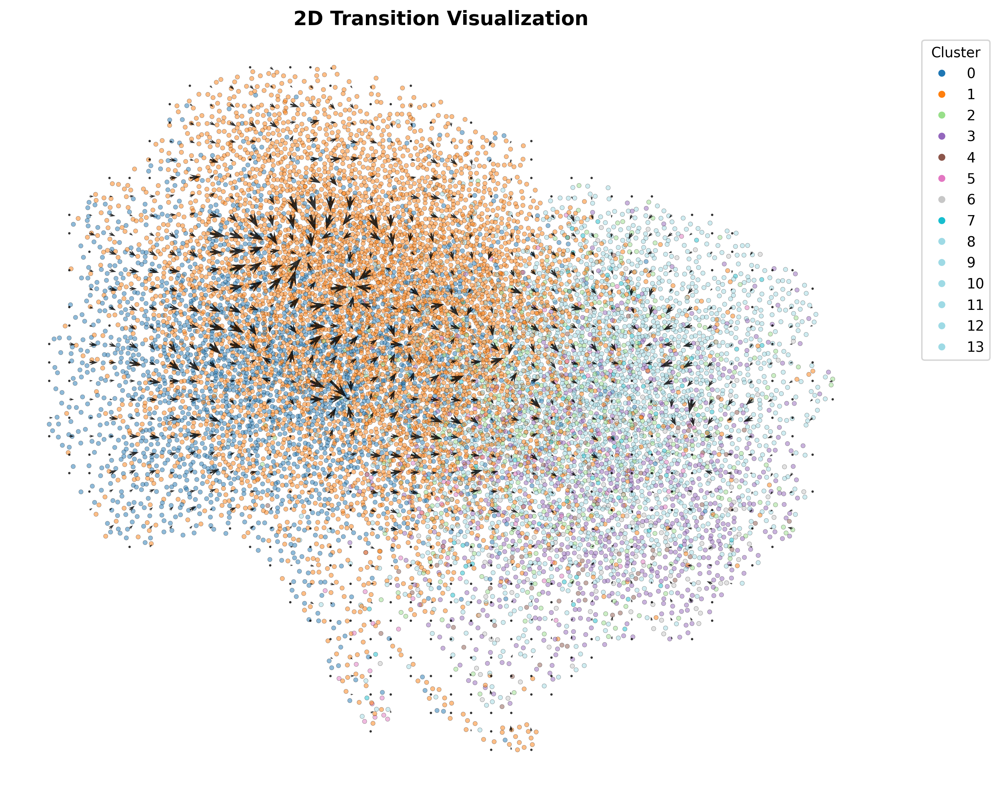

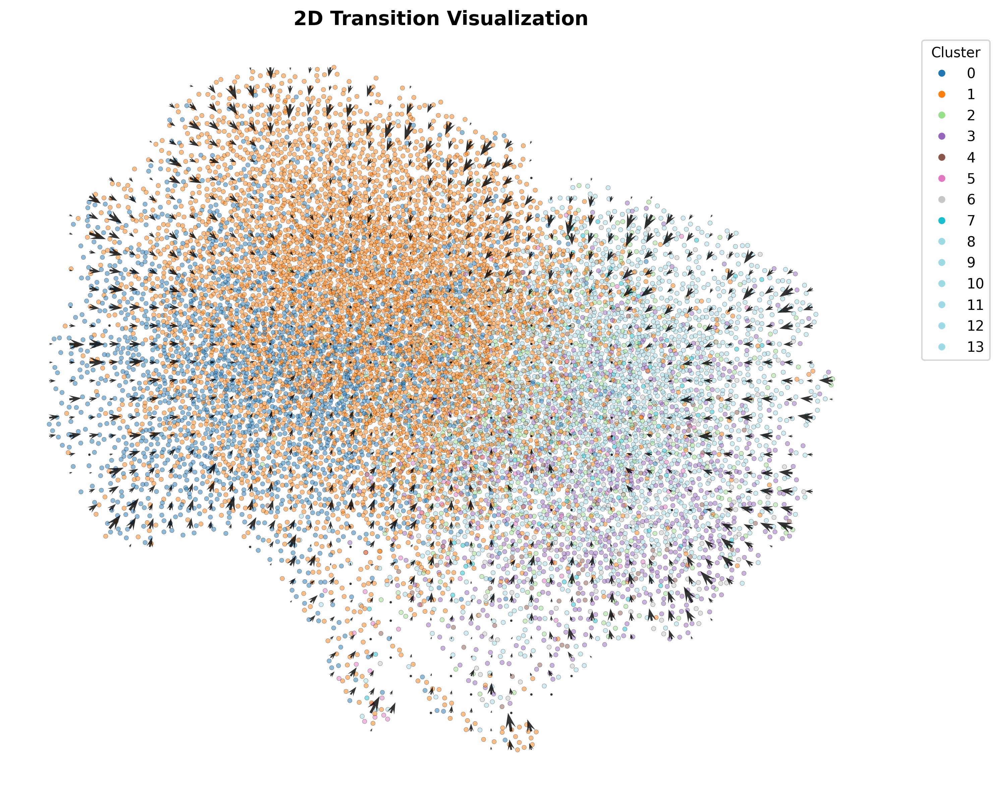

In [20]:
# Enforce transitions within nearest neighbors of beta embedding

estimate_transitions_2D(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], 
    annot='beta_labels', normalize=True, grid_scale=0.2, vector_scale=0.8, n_jobs=1,
    savepath=f'{results_dir}/transitions/beta/{goi}.png')

randomize_transitions_2D(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], 
    annot='beta_labels', normalize=True, grid_scale=0.2, vector_scale=0.8, n_jobs=1, 
    savepath=f'{results_dir}/transitions/beta/{goi}_randomized.png')

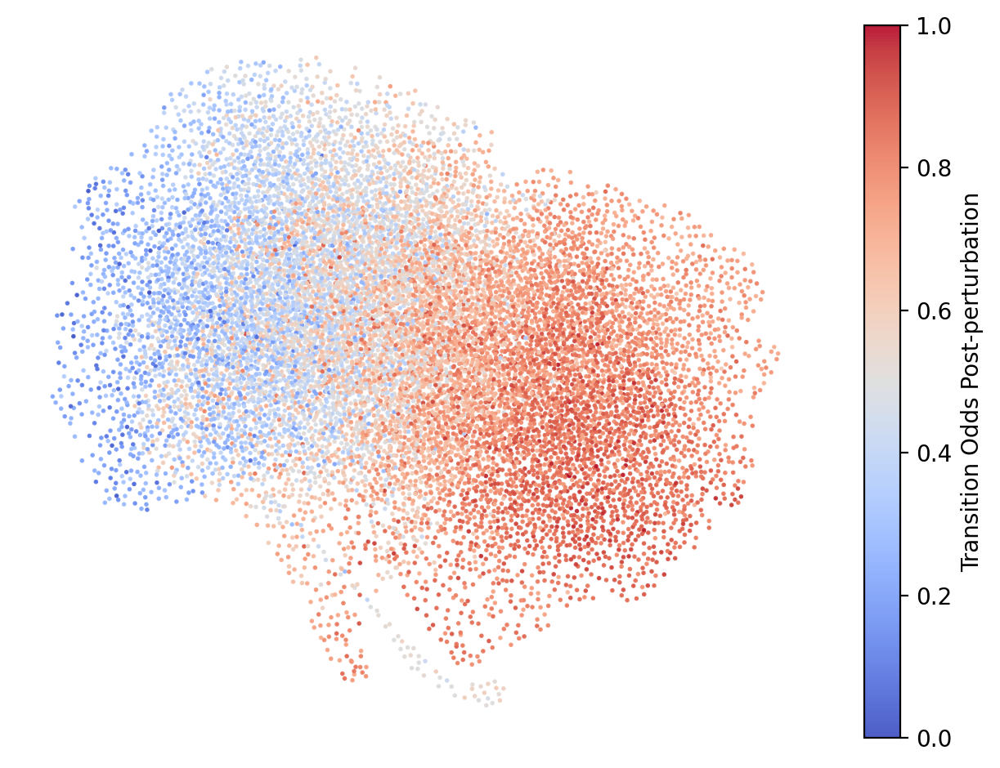

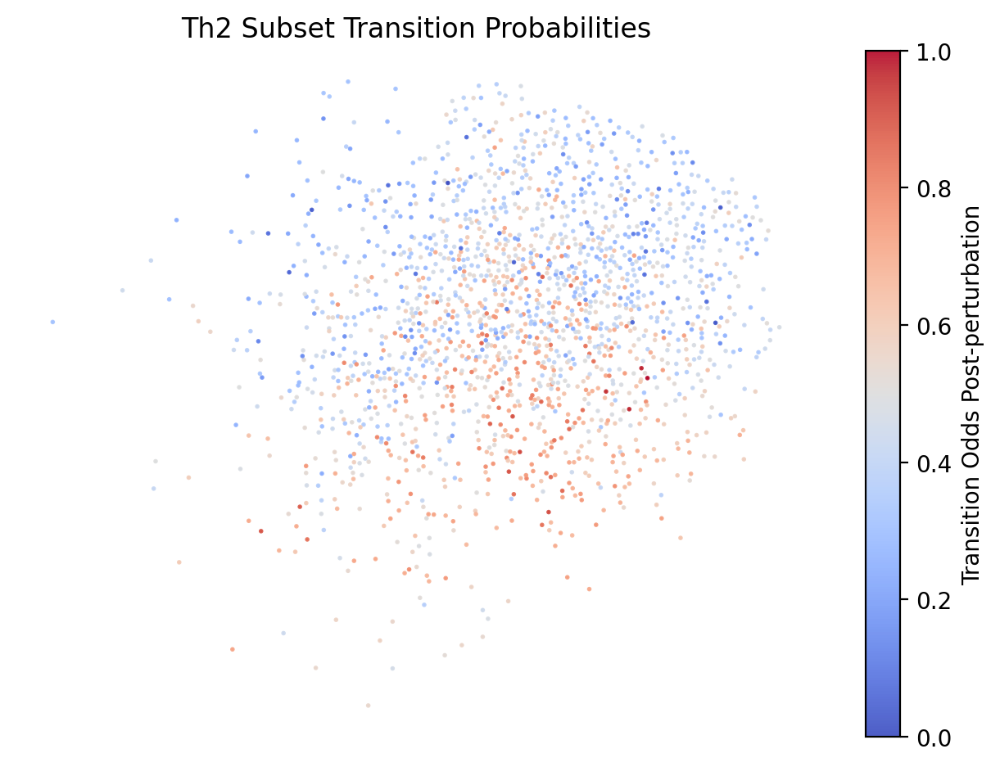

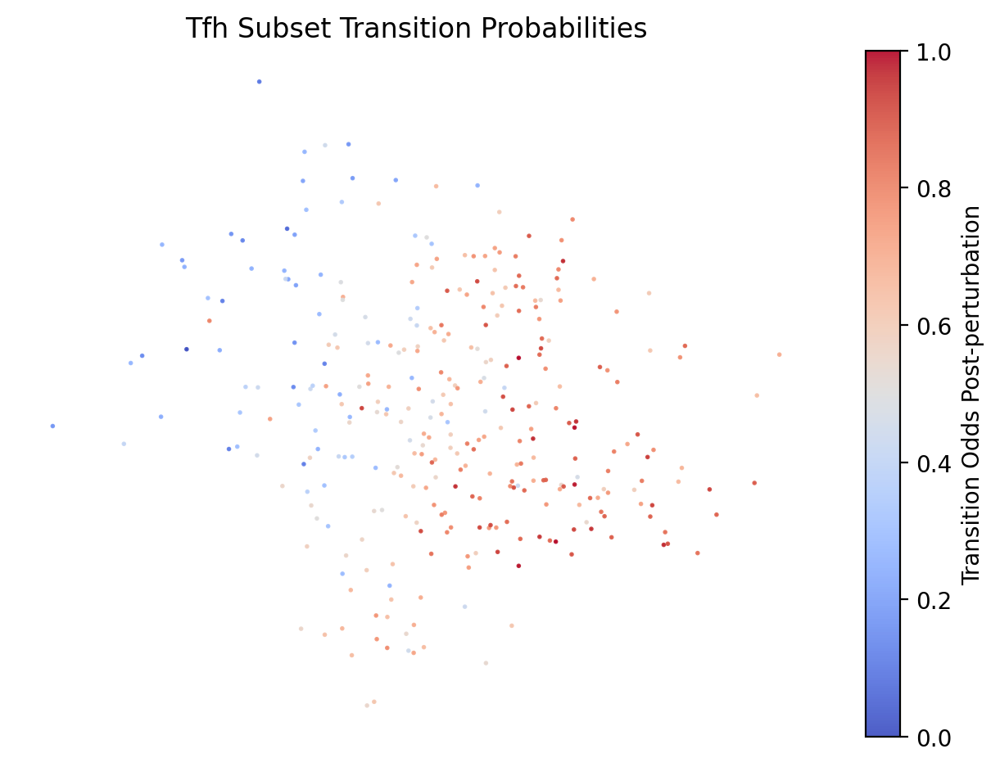

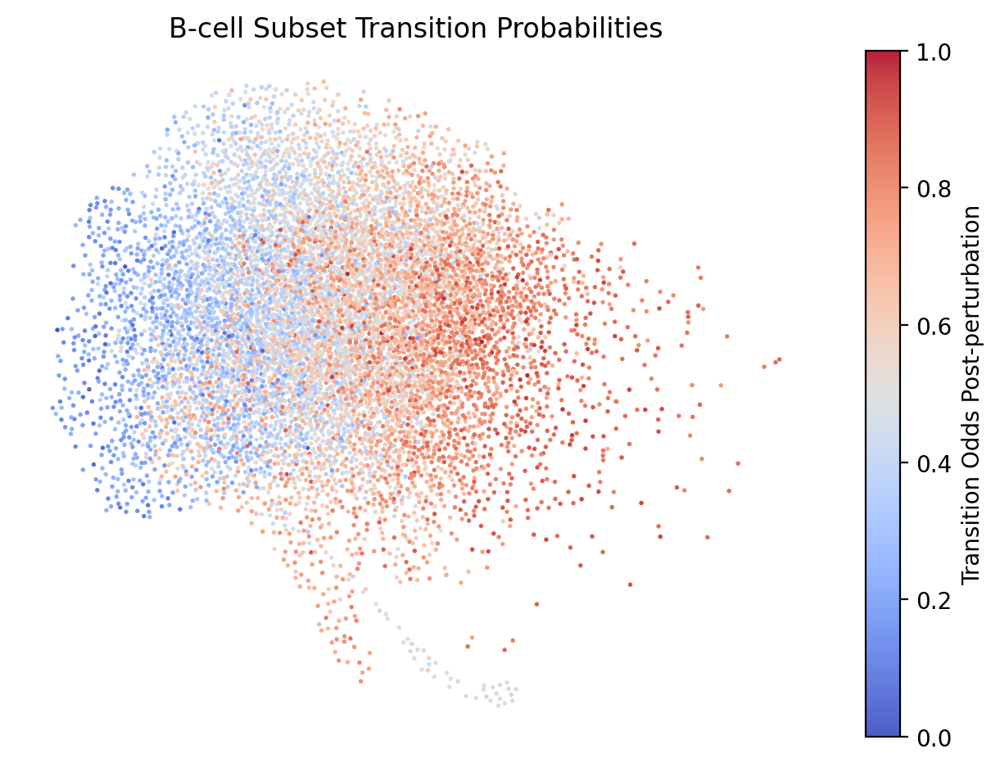

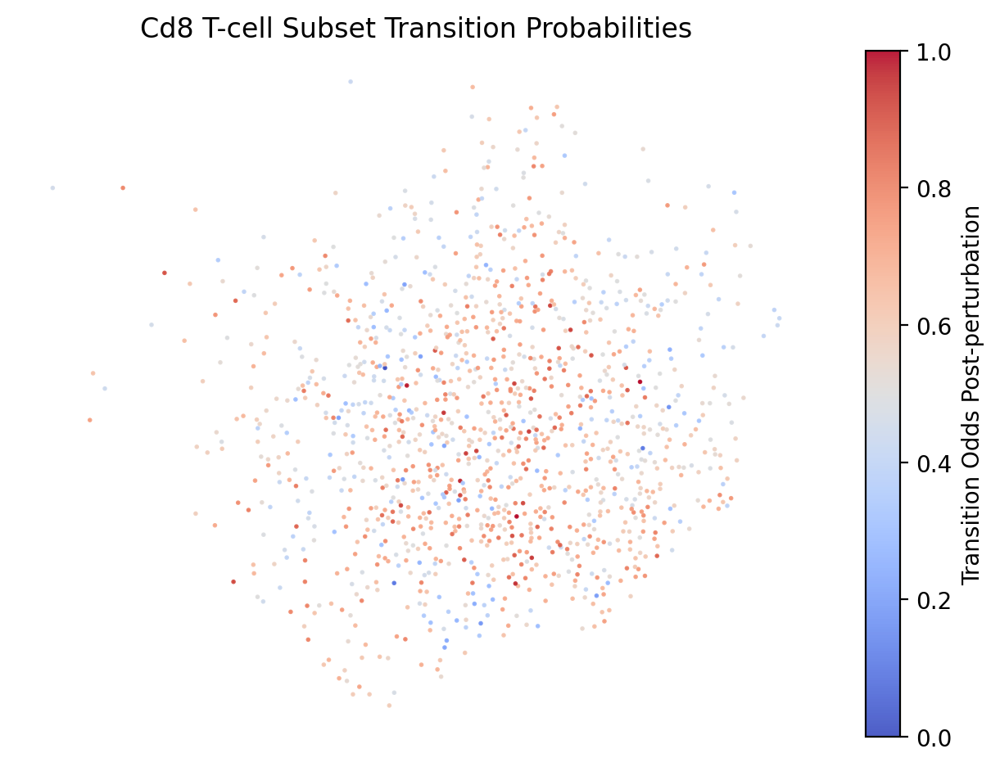

<Figure size 640x480 with 0 Axes>

In [21]:
estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], cluster='Th2', annot='rctd_celltypes', n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], cluster='Tfh', annot='rctd_celltypes', n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], cluster='B-cell', annot='rctd_celltypes', n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], cluster='Cd8 T-cell', annot='rctd_celltypes', n_jobs=1)

### Spatial transitions

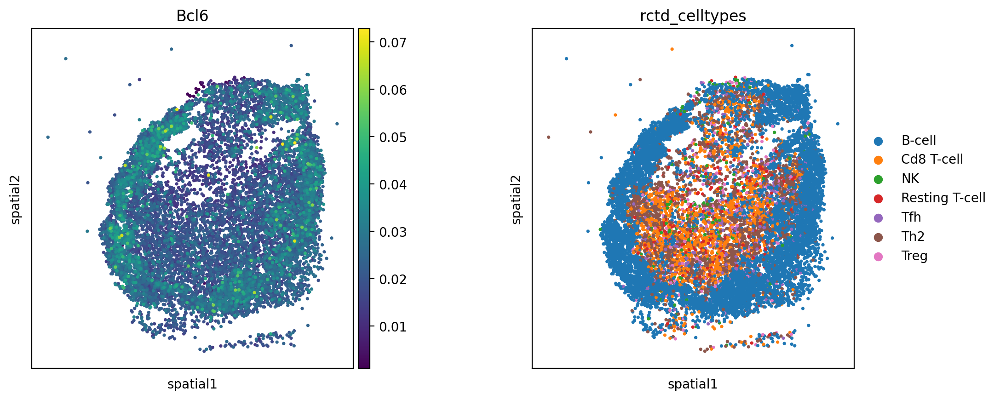

In [22]:
compare_gex(so.adata, annot='rctd_celltypes', goi=goi, embedding='spatial')

Computing vectors: 100%|██████████| 1680/1680 [00:00<00:00, 39857.18it/s]


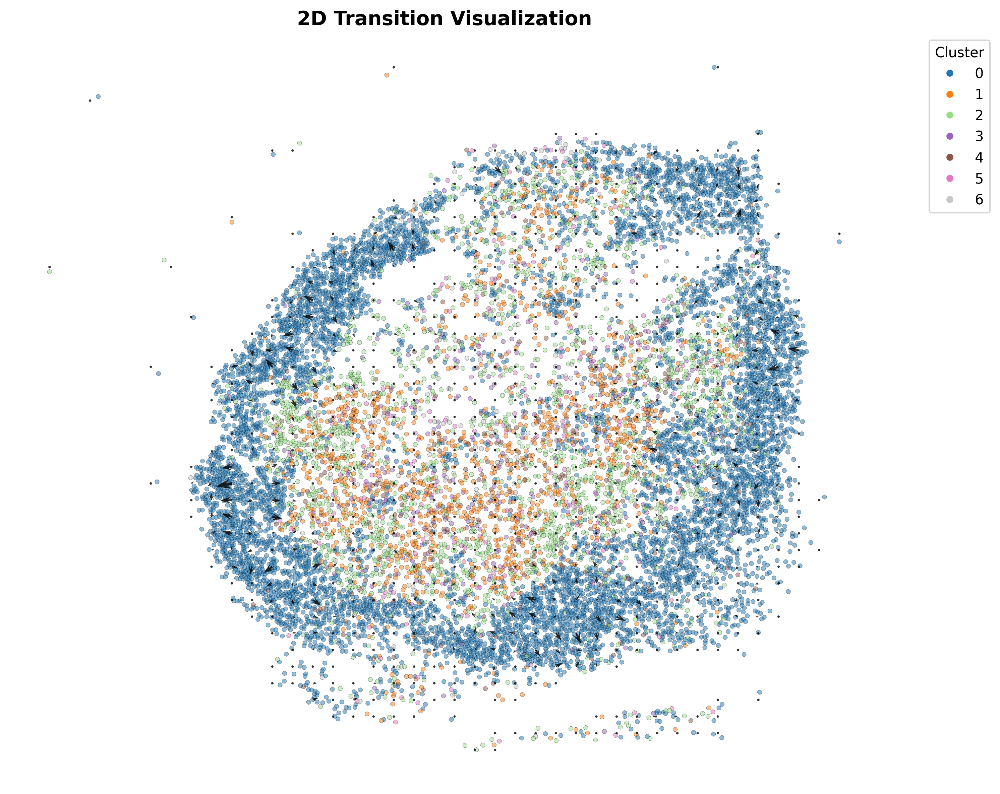

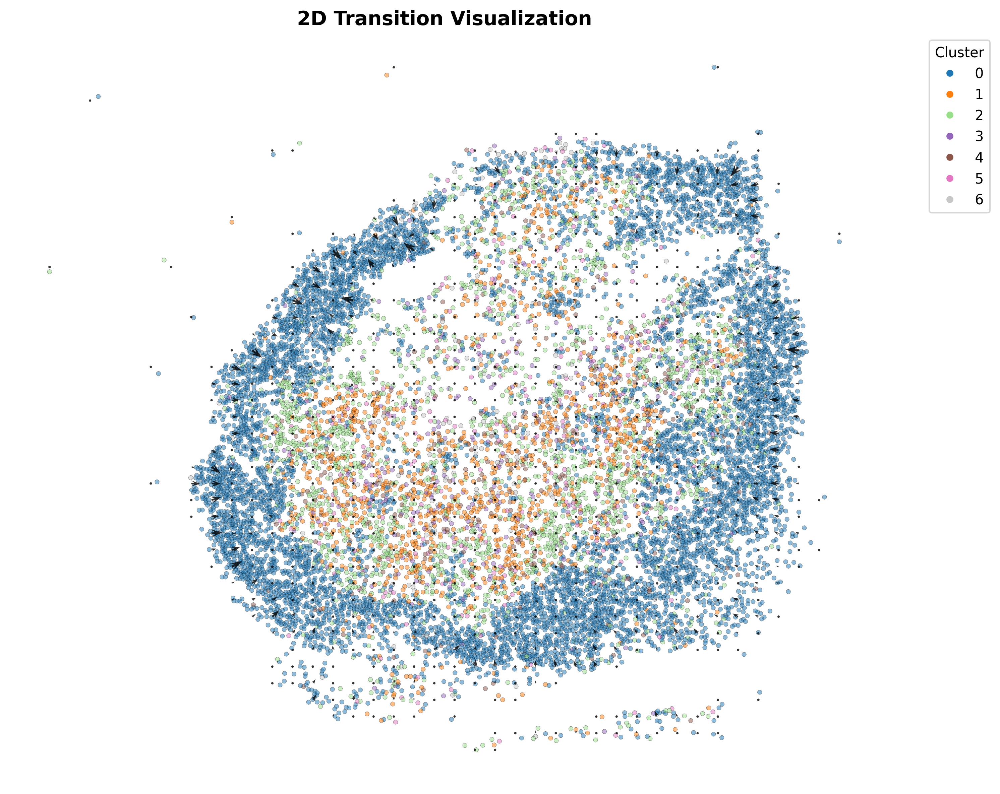

In [23]:
# Enforce transitions within nearest neighbors of spatial embedding

estimate_transitions_2D(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_spatial'], 
    annot='rctd_cluster', normalize=True, vector_scale=60, n_jobs=1, 
    savepath=f'{results_dir}/transitions/spatial/{goi}.png')

randomize_transitions_2D(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_spatial'], 
    annot='rctd_cluster', normalize=True, vector_scale=60, n_jobs=1, 
    savepath=f'{results_dir}/transitions/spatial/{goi}_randomized.png')

In [ ]:
estimate_celltype_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_spatial'], 
    annot='rctd_celltypes', n_neighbors=200, vector_scale=40,
    visual_clusters=['B-cell', 'Th2', 'Tfh'], n_jobs=1,
    savepath=f'{results_dir}/transitions/celltype/{goi}_celltypes.png')

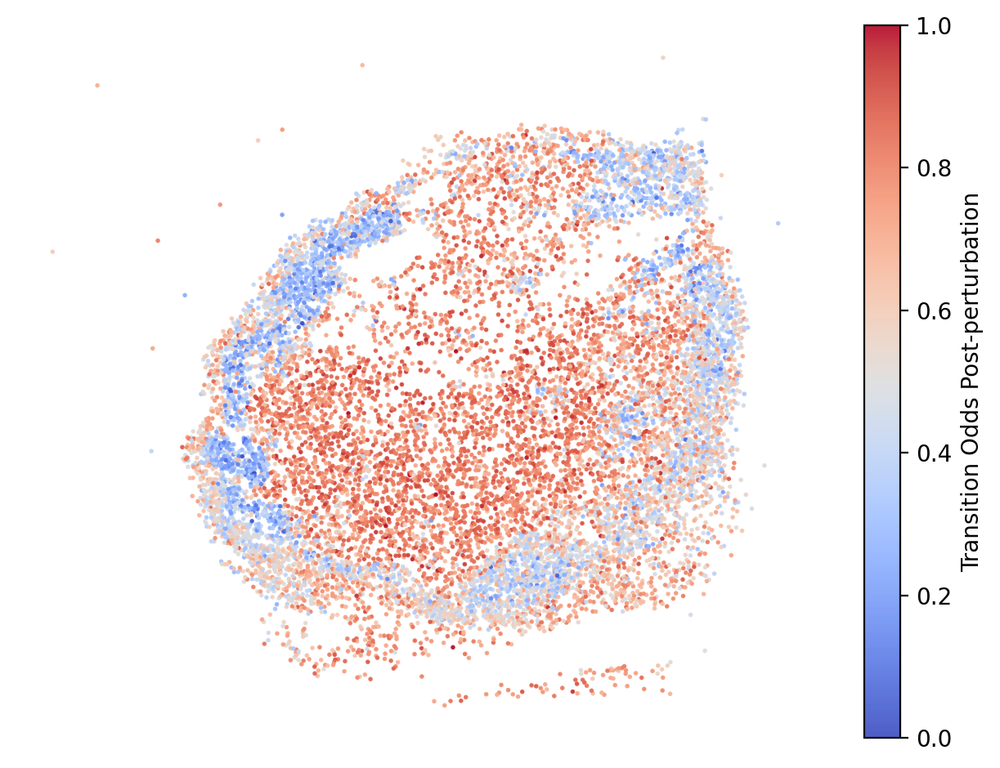

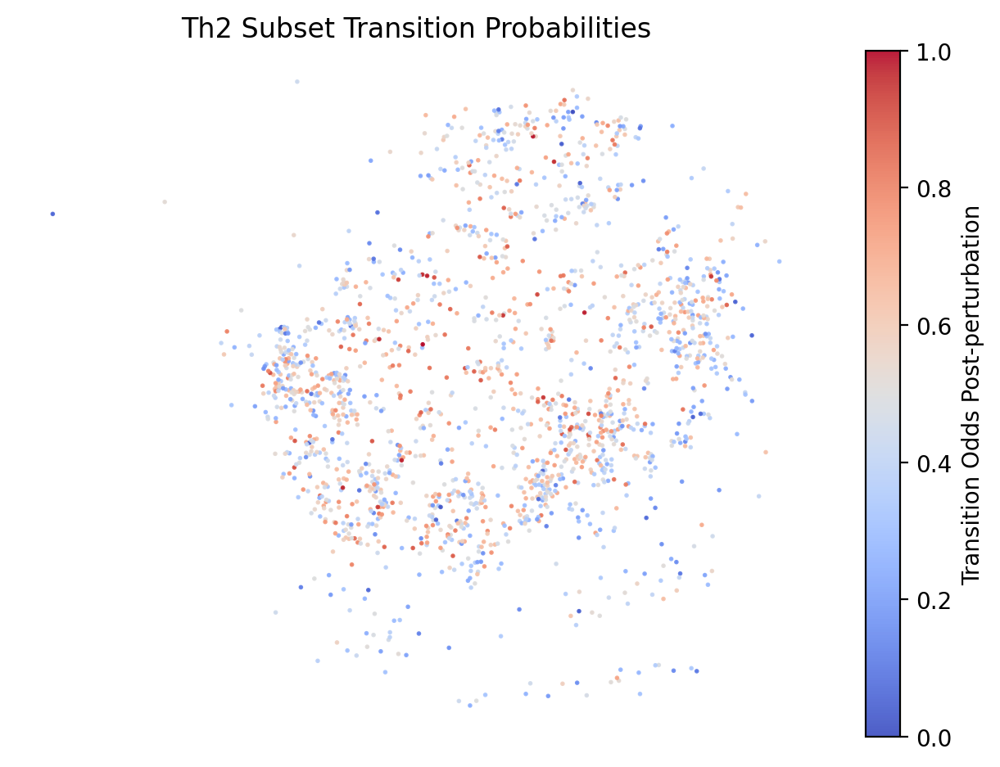

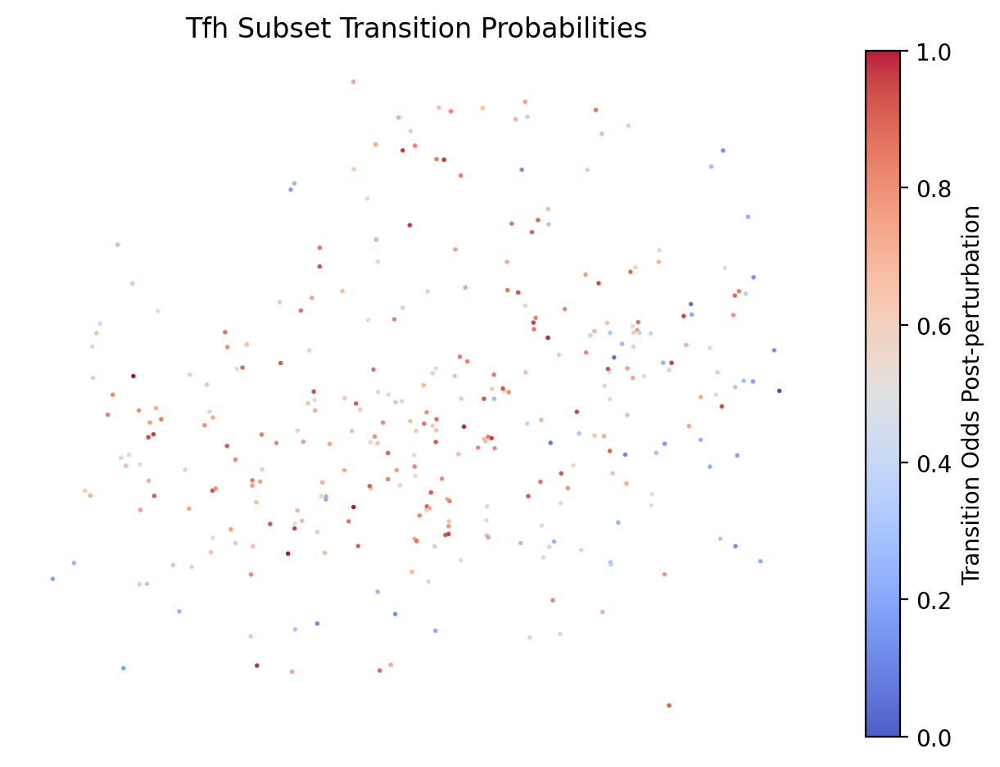

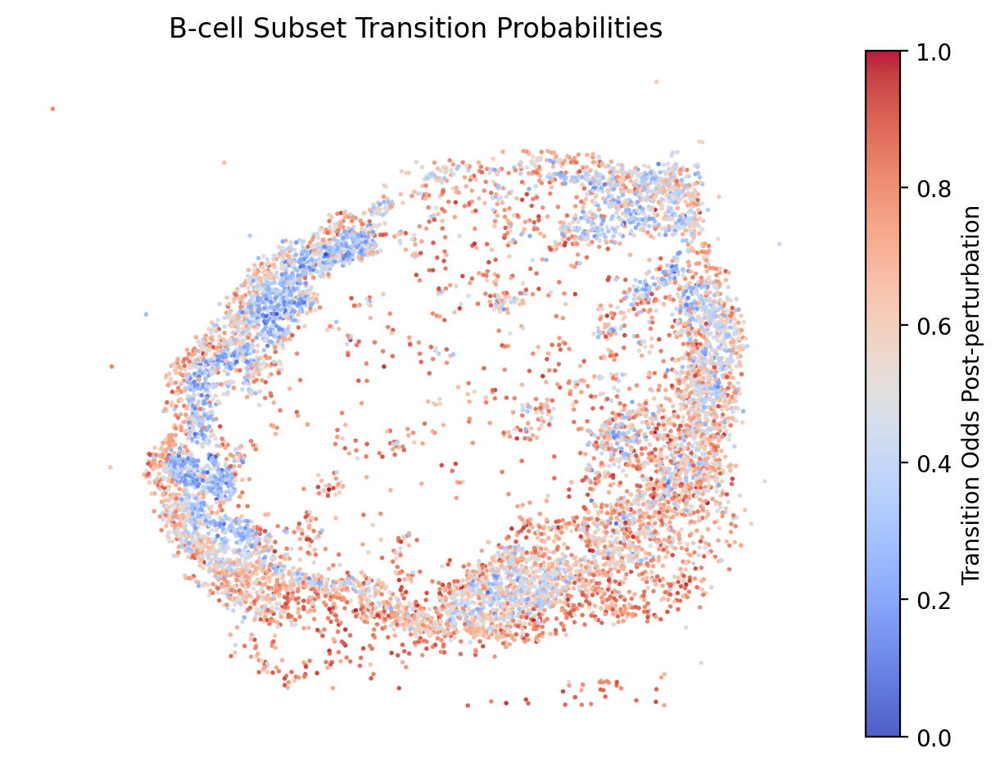

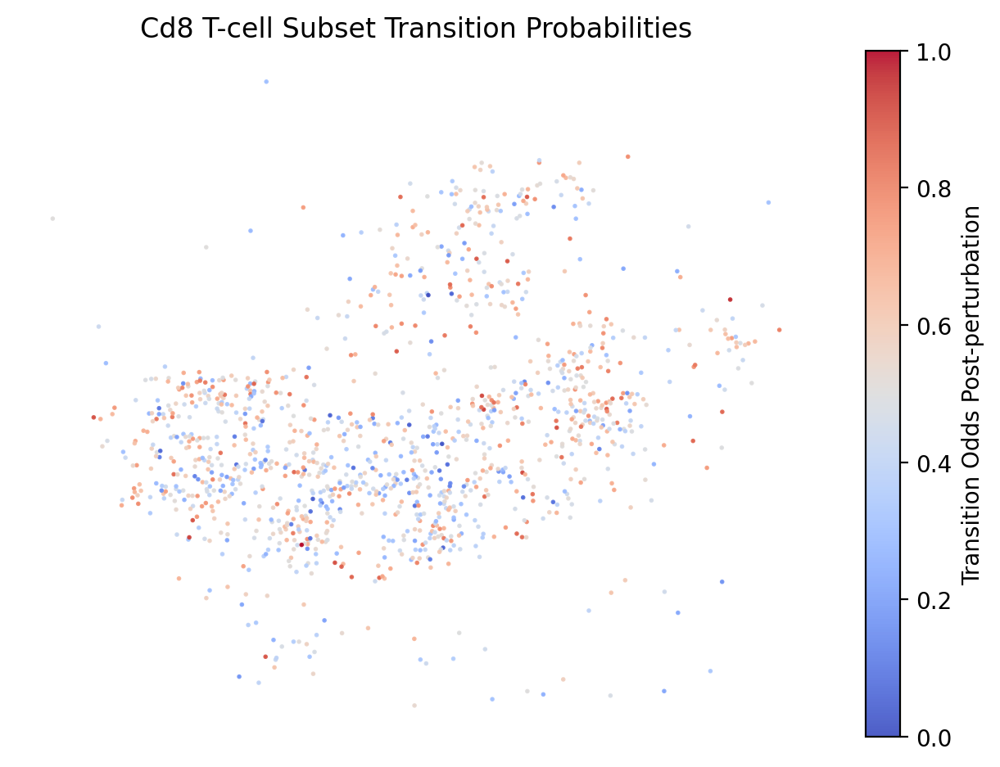

<Figure size 640x480 with 0 Axes>

In [25]:
estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['spatial'], n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['spatial'], cluster='Th2', annot='rctd_celltypes', n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['spatial'], cluster='Tfh', annot='rctd_celltypes', n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['spatial'], cluster='B-cell', annot='rctd_celltypes', n_jobs=1)

estimate_celltocell_transitions(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['spatial'], cluster='Cd8 T-cell', annot='rctd_celltypes', n_jobs=1)

### FR embedding

In [ ]:
# from spaceoracle.plotting.transitions import *
# from spaceoracle.plotting.randomize import *

# compare_gex(so.adata, annot='rctd_celltypes', goi=goi, embedding='PCA')
# compare_gex(so.adata, annot='rctd_celltypes', goi=goi, embedding='UMAP')
compare_gex(so.adata, annot='rctd_celltypes', goi=goi, embedding='FR')

sc.get.obs_df(so.adata, keys=[goi], layer="imputed_count").hist()
so.pcs = so.perform_PCA(so.adata)
so.knn_imputation(so.adata, so.pcs)

estimate_transitions_2D(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], 
    annot='rctd_cluster', grid_scale=2, vector_scale=0.5, n_jobs=4)

randomize_transitions_2D(
    so.adata, so.adata.layers['delta_X'], so.adata.obsm['X_draw_graph_fr'], 
    annot='rctd_cluster', grid_scale=2, vector_scale=0.5, n_jobs=4)



### 3D transitions

In [ ]:
celltypes = ['B-cell', 'Cd8 T-cell']

cell_idxs = np.where(adata.obs['rctd_celltypes'].isin(celltypes))[0]
adata_ct = adata[adata.obs_names[cell_idxs]]
delta_X_ct = so.adata.layers['delta_X'][cell_idxs, :]

# view_spatial3D(adata_ct, annot='rctd_celltypes', flat=True, show=True)
embedding_ct = view_spatial3D(adata_ct, annot='rctd_celltypes', flat=True, show=False)

In [ ]:
estimate_transitions_3D(
    adata_ct, delta_X_ct, embedding_ct, annot='rctd_celltypes', 
    normalize=True, grid_scale=0.01, vector_scale=1, n_jobs=1)

In [ ]:
celltypes = ['Th2', 'Cd8 T-cell']

cell_idxs = np.where(adata.obs['rctd_celltypes'].isin(celltypes))[0]

adata_ct = adata[adata.obs_names[cell_idxs]]
delta_X_ct = so.adata.layers['delta_X'][cell_idxs, :]

# view_spatial3D(adata_ct, annot='rctd_celltypes', flat=True, show=True)
embedding_ct = view_spatial3D(adata_ct, annot='rctd_celltypes', flat=True, show=False)

estimate_transitions_3D(
    adata_ct, delta_X_ct, embedding_ct, annot='rctd_celltypes', 
    normalize=True, grid_scale=0.01, vector_scale=1, n_jobs=1)

In [ ]:
from spaceoracle.plotting.similarity import *

plot_similarity_chains(
    so.adata, annot='rctd_cluster', n=5, ax=None, cluster=0, figsize=(6, 6))